In [2]:
%load_ext autoreload
%autoreload 2

# Ovrlpy analysis tutorial of Xenium mouse brain data

In [3]:
from pathlib import Path

data_folder_path = Path("/dh-projects/ag-ishaque/raw_data/tiesmeys-ovrlpy/Xenium-brain-2024/replicate1")

kde_bandwidth = 2.0
um_per_pixel = 2.0
min_expression = 1.5


In [4]:
import pandas as  pd
# import scanpy as sc
# import squidpy as sq

coordinate_df = pd.read_parquet(data_folder_path/"transcripts.parquet")
coordinate_df["feature_name"]=coordinate_df.feature_name.str.decode("utf-8")


# remove dummy molecules:
dummy_mask = (coordinate_df.feature_name.str.contains('BLANK') | coordinate_df.feature_name.str.contains('NegControl'))
coordinate_df = coordinate_df[~dummy_mask]

# format columns:
coordinate_df = coordinate_df[['x_location','y_location','z_location','feature_name','cell_id','overlaps_nucleus','qv']]
coordinate_df.columns = ['x','y','z','gene','cell_id','overlaps_nucleus','qv']
coordinate_df['gene'] = coordinate_df['gene'].astype("category")

# scale coordinates to pixels:
coordinate_df.x /= um_per_pixel
coordinate_df.y /= um_per_pixel
coordinate_df.z /= um_per_pixel


coordinate_df.head()

,x,y,z,gene,cell_id,overlaps_nucleus,qv
0,2421.522949,3213.864990,9.534434,Bhlhe40,67490,1,40.000000
1,2422.316406,3111.591309,9.260080,Parm1,67957,0,40.000000
2,2421.471680,3239.155273,9.250054,Bhlhe40,67539,1,13.813585
3,2421.970703,3172.275146,7.508077,Lyz2,68003,0,19.471884
4,2421.581299,3316.055908,7.697340,Dkk3,67344,0,40.000000


In [5]:
from src import ovrlp 
import random

random.seed(42)

coherence, signal, visualizer = ovrlp.compute_coherence_map(df=coordinate_df,KDE_bandwidth=kde_bandwidth)


/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/src/ovrlp.py:99: RuntimeWarning: Mean of empty slice
  elevation_map_ = np.nanmean([elevation_map,np.roll(elevation_map,1,axis=0)],axis=0)/4
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/src/ovrlp.py:100: RuntimeWarning: Mean of empty slice
  elevation_map_ += np.nanmean([elevation_map,np.roll(elevation_map,1,axis=1)],axis=0)/4
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/src/ovrlp.py:101: RuntimeWarning: Mean of empty slice
  elevation_map_ += np.nanmean([elevation_map,np.roll(elevation_map,-1,axis=0)],axis=0)/4
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/src/ovrlp.py:102: RuntimeWarning: Mean of empty slice
  elevation_map_ += np.nanmean([elevation_map,np.roll(elevation_map,-1,axis=1)],axis=0)/4


['Optional', 'ThreadPoolExecutor', 'Union', '__builtins__', '__cached__', '__doc__', '__file__', '__loader__', '__name__', '__package__', '__spec__', '_sample_expression_2d', '_sample_expression_3d', 'anndata', 'as_completed', 'count_cells_at_localmax', 'np', 'pd', 'plt', 'produce_map', 'produce_map_3d', 'sample_expression', 'tqdm', 'utils']
Analyzing in 3d mode:
determining local maxima:
0 2569 1 1760 0 9
found 42637 local maxima


/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/.conda-env/lib/python3.12/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


sampling expression:


Zfp536: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 248/248 [00:16<00:00, 14.87it/s]
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/.conda-env/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/.conda-env/lib/python3.12/site-packages/numpy/_core/_methods.py:130: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/.conda-env/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/dh-projects/ag-ishaque/analysis/tiesmeys/src/ovrlpy-dev/.conda-env/lib/python3

[   0 1027 2055 3082 4110 5138] [   0 1173 2346 3519]


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [01:56<00:00,  7.74s/it]


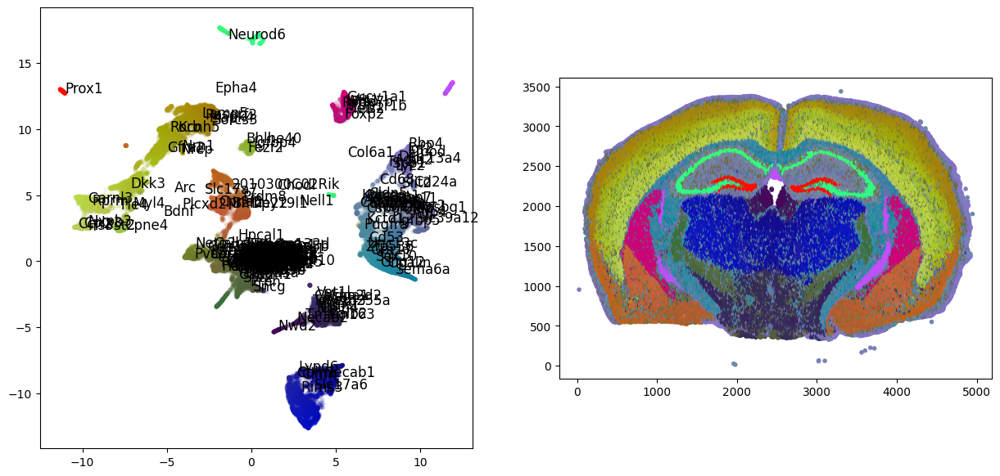

In [6]:
visualizer.plot_fit()

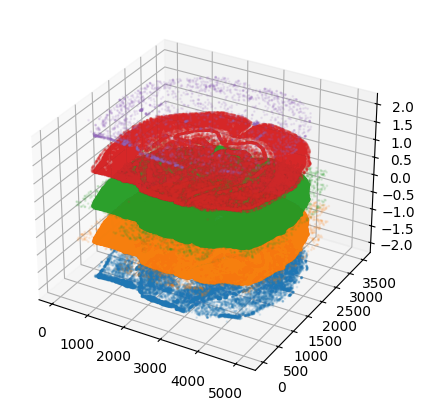

In [7]:
import matplotlib.pyplot as plt
import numpy as np 

plt.figure(figsize=(20,5,))

ax = plt.subplot(111,projection='3d')

for i in range(-2,3):
    subset = coordinate_df[(coordinate_df.z-coordinate_df.z_delim).between(i,i+1)]
    
    ax.scatter(subset.x[::100],subset.y[::100],np.zeros(1+(len(subset)//100))+i,s=1,alpha=0.1)
    

In [8]:
adata = sc.read_mtx(data_folder_path/"cell_feature_matrix/matrix.mtx").T
adata.var = pd.read_csv(data_folder_path/"cell_feature_matrix/features.tsv", header=None, index_col=1, names=["gene_id", "gene", "feature_type"],sep="\t")
obs_dict = pd.read_parquet(data_folder_path/"cells.parquet",)#.set_index("cell_id")
for c in obs_dict.columns:
    adata.obs[c] = obs_dict[c].values
adata.obs.set_index("cell_id",inplace=True)
adata.obs.index = adata.obs.index.astype("category")
adata.obs[['x_centroid','y_centroid']]/=um_per_pixel

# Filter out empty cells:
# adata = adata[adata.X.sum(axis=1)>50]

NameError: name 'sc' is not defined

/home/tiesmeys/miniconda3/envs/spatial2022/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3472: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


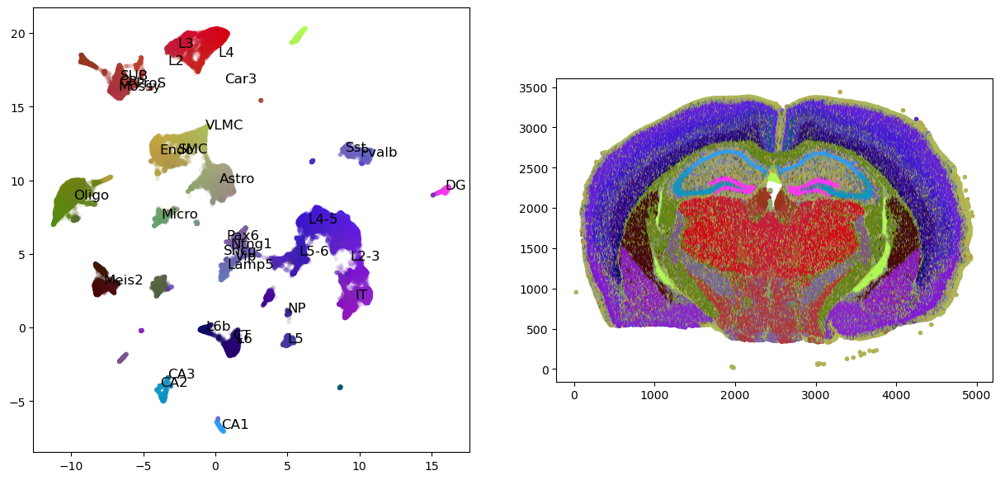

In [8]:
import numpy as np
import matplotlib.pyplot as plt

signatures_ = pd.read_csv('/dh-projects/ag-ishaque/raw_data/Xenium-benchmark/scRNAseq/trimmed_means.csv',index_col=0)

signatures_ = signatures_.T.groupby(lambda x: x.split('_')[1].split(' ')[0].split('-')[0]).apply(np.mean).T

signatures = pd.DataFrame(index=visualizer.genes,columns=signatures_.columns)
signatures = signatures.fillna(0)

for gene in visualizer.genes:
    if gene in signatures_.index:
        signatures.loc[gene] = signatures_.loc[gene]

del signatures_ 

signatures.columns=signatures.columns.str.replace('/','-')

visualizer.fit_signatures(signatures)

visualizer.plot_fit()

plt.savefig("./manuscript/figures/results/xenium-brain/ct_fit.svg")

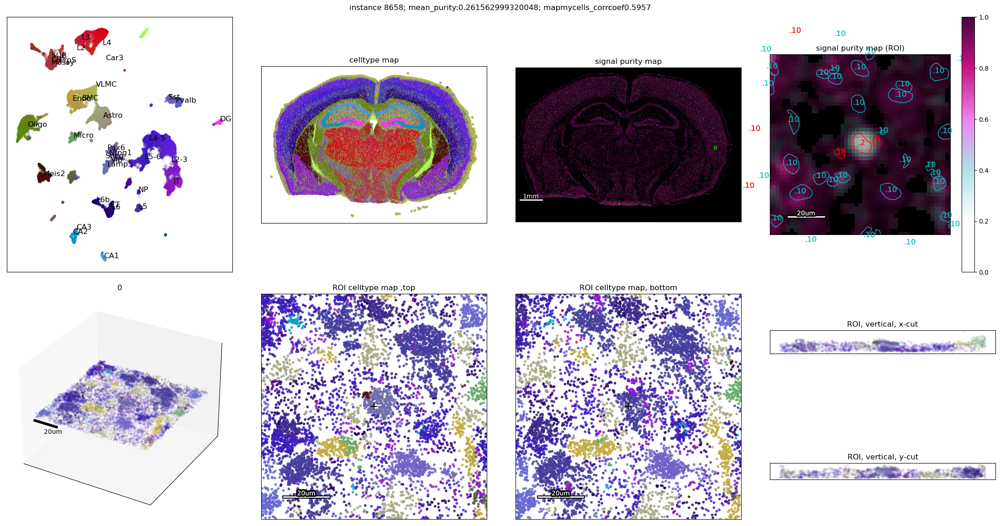

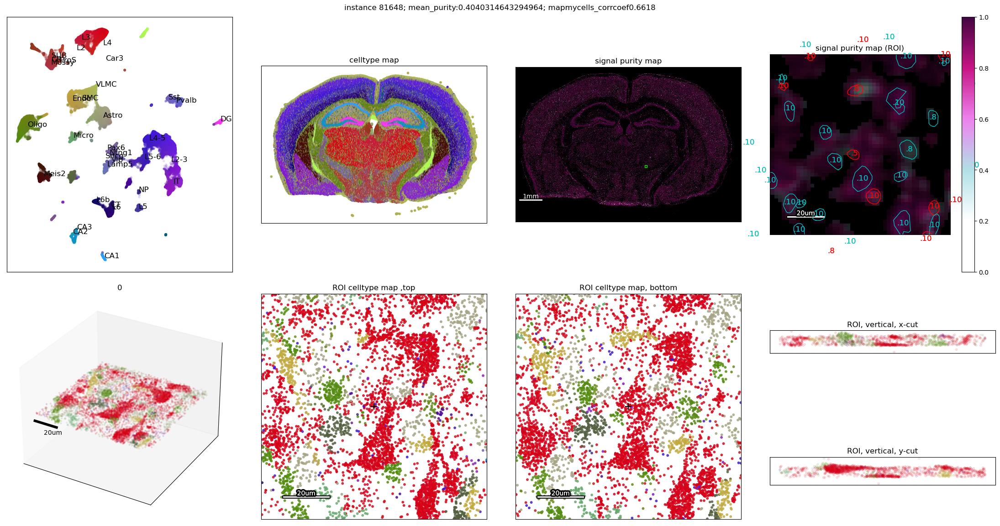

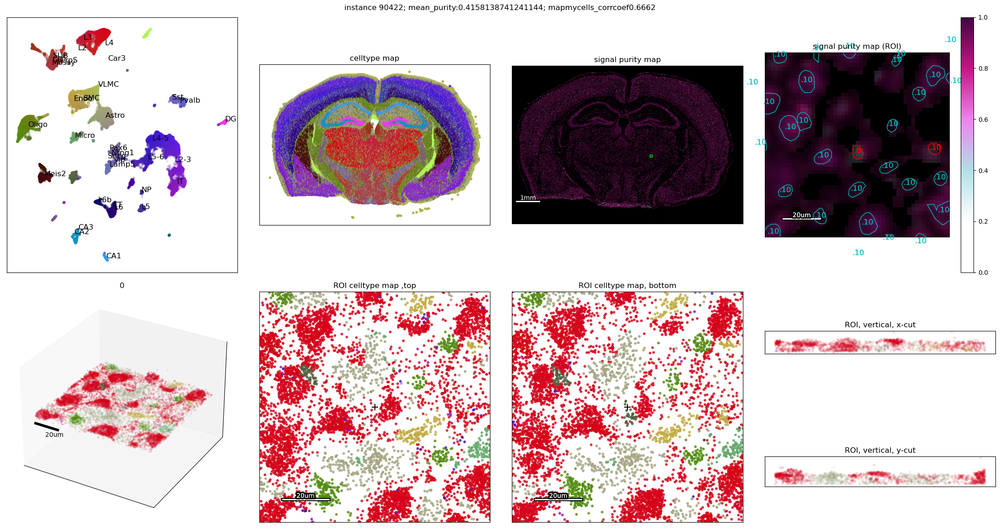

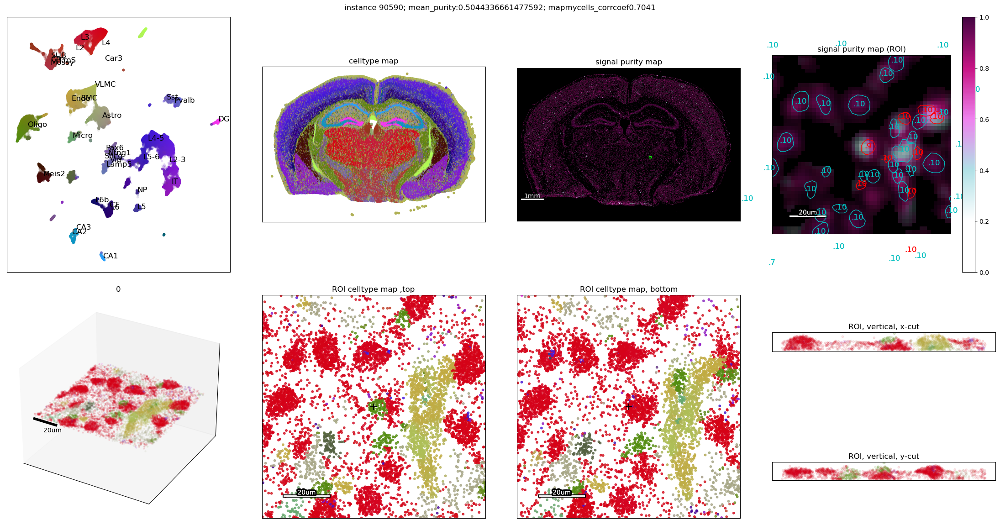

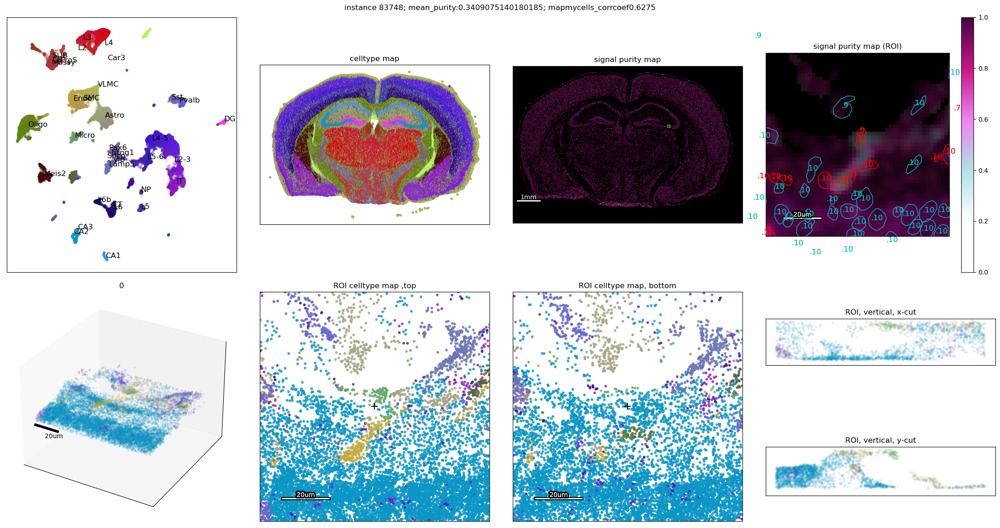

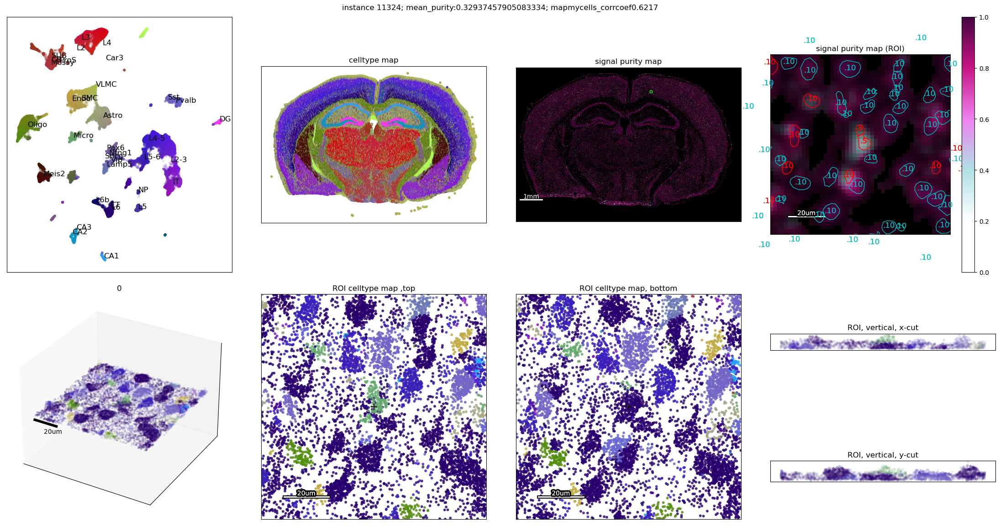

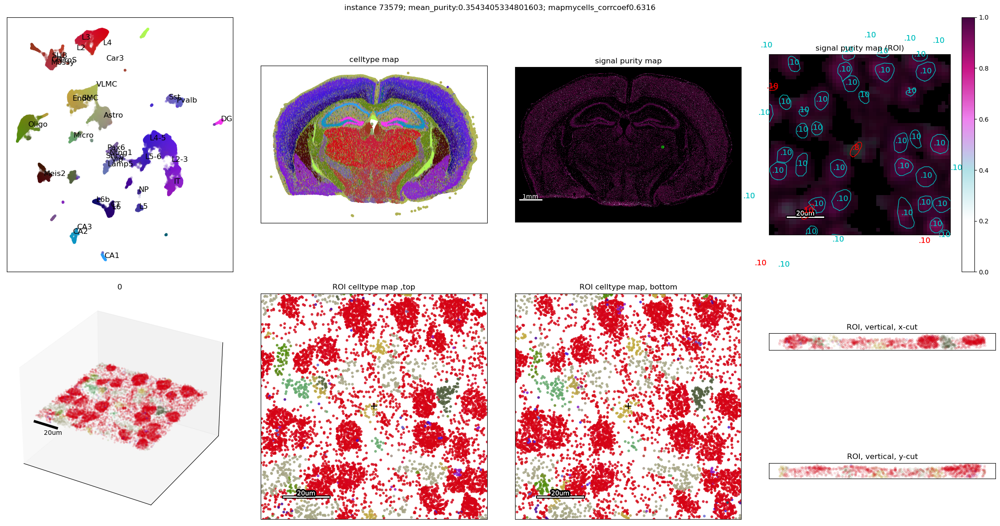

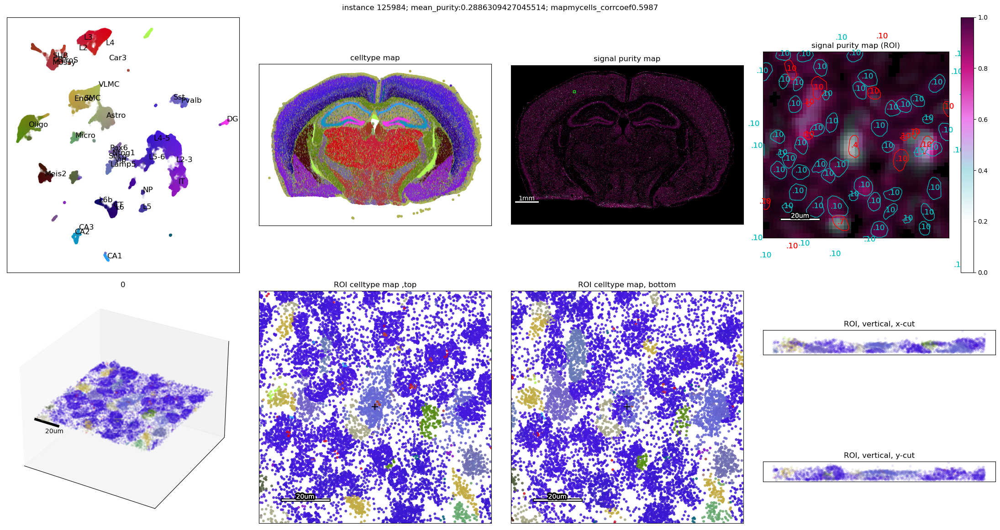

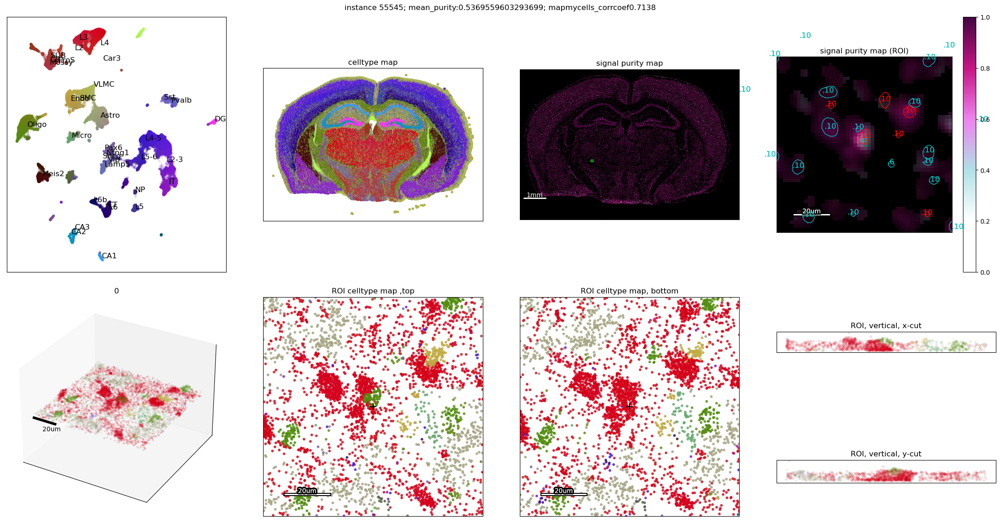

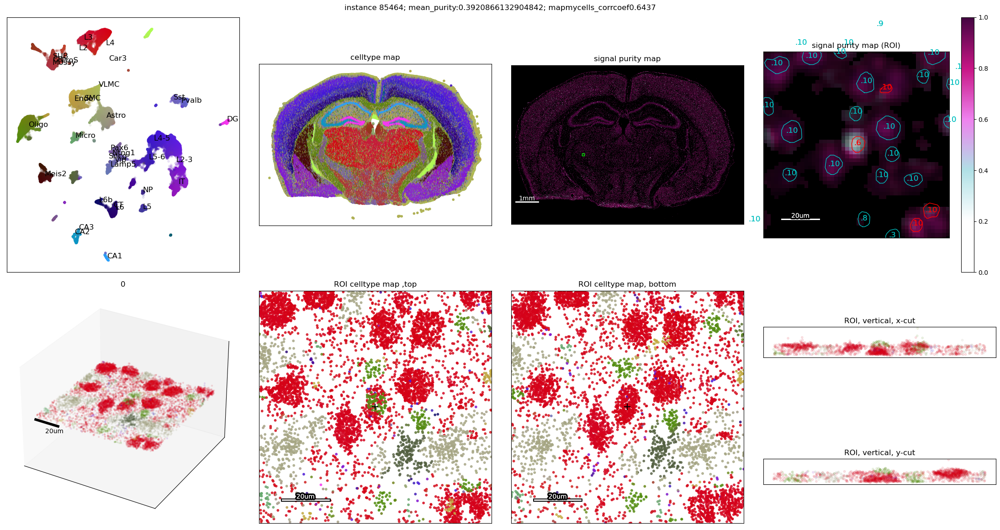

In [86]:
# Drawing out the four regions of interest:

import matplotlib.patches as patches
from src.utils import plot_scalebar
import random
from matplotlib.colors import LinearSegmentedColormap

cmap = LinearSegmentedColormap.from_list('', ['#430541','mediumvioletred','violet','powderblue','white','white'][::-1])
mapmycells_top_bottom_match = (mapmycells_df_top.family_name == mapmycells_df_bottom.family_name)

def plot_cells(cells_present,ax):
    nucleus_boundaries[nucleus_boundaries.cell_id.isin(cells_present)]

    for i,c in enumerate(cells_present):
        
        boundary_subset = nucleus_boundaries[nucleus_boundaries.cell_id==c]
        
        if c in adata.obs.index:
                
            color = 'c' if mapmycells_top_bottom_match[c] else 'r'
            
            plt.plot(boundary_subset.vertex_x,boundary_subset.vertex_y,c=color,linewidth=1)
            
            # mean_purity = adata.obs[adata.obs.index==c].mean_purity.iloc[0]
            mean_purity = adata.obs[adata.obs.index==c].above_threshold.iloc[0]

            if not np.isnan(mean_purity):

                text = plt.text(boundary_subset.vertex_x.mean(),boundary_subset.vertex_y.mean(),f".{int(mean_purity*10)}",fontsize=12,ha='center',color=color)
                plt.gca().add_artist(text)


data_mask = (np.array(adata.X.sum(1)>50).flatten()&(adata.obs["area"]>10))
ovrlpy_impure_xenium_impure = ((1/adata.obs.mean_purity/adata.obs.mapmycells_corrcoef)[data_mask]).sort_values()
ovrlpy_pure_xenium_impure = ((adata.obs.mean_purity-adata.obs.mapmycells_corrcoef)[data_mask]).sort_values()
ovrlpy_impure_xenium_pure = (((adata.obs.mean_purity+1)/adata.obs.mapmycells_corrcoef)[data_mask]).sort_values()
# ovrlpy_pure_xenium_pure = ((adata.obs.mean_purity*adata.obs.mapmycells_corrcoef)[data_mask]).sort_values()

# adata.obs[(adata.obs.mean_purity<0.3)&(adata.obs.mapmycells_corrcoef<0.3)]
# ovrlpy_pure_xenium_impure = adata.obs[(adata.obs.mean_purity>0.8)&(adata.obs.mapmycells_corrcoef<0.3)]
# ovrlpy_impure_xenium_pure = adata.obs[(adata.obs.mean_purity<0.3)&(adata.obs.mapmycells_corrcoef>0.5)]
# ovrlpy_pure_xenium_pure = adata.obs[(adata.obs.mean_purity>0.8)&(adata.obs.mapmycells_corrcoef>0.5)]
            
window_size = 25

plotting_signal_cutoff = 20

for n in (ovrlpy_impure_xenium_pure.index[5:15]):
    
    sample = adata.obs.loc[n,['x_centroid','y_centroid'],]
    random.seed(42)

    signal__ = signal_.copy()
    signal__ [signal__>plotting_signal_cutoff]=plotting_signal_cutoff
    signal__[signal__<3]=0
    signal__/=signal__.max()

    x,y = sample# np.array(sample).sum(1)[::-1]//2


    subsample = visualizer.subsample_df(x,y,coordinate_df,window_size=window_size)
    subsample_embedding, subsample_embedding_color = visualizer.transform(subsample)

    visualizer.plot_instance(subsample,subsample[['x','y']].values,subsample_embedding_color,x,y,window_size=window_size,rasterized=True)

    # print(f'instance visualizerualization runtime: {time.perf_counter()-perf_}')

    fig = plt.gcf()

    plt.suptitle(f'instance {n+1}; mean_purity:{adata.obs.loc[n].mean_purity}; mapmycells_corrcoef{adata.obs.loc[n].mapmycells_corrcoef}')
    gs = (fig.get_axes()[0]).get_gridspec()

    ax =  fig.add_subplot(gs[0,2], facecolor='k')
    ax.set_title('signal purity map')

    ax.imshow(coherence_.T**1, cmap=cmap, vmin= 0.0, vmax=1.0, alpha = signal__.T, interpolation='nearest')

    ax.invert_yaxis()
    plot_scalebar(ax,100,500,500,text='1mm',color='w',edge_color=None)
    ax.set_xticks([])
    ax.set_yticks([])

    # Create a Rectangle patch
    rect = patches.Rectangle((x-window_size, y-window_size), window_size*2, window_size*2, linewidth=1, edgecolor='lime', facecolor='none')
    ax.add_patch(rect)

    ax = fig.add_subplot(gs[0,3], facecolor='k')
    ax.set_title('signal purity map (ROI)')

    plt.imshow(coherence_.T**1, cmap=cmap, vmin= 0.0, vmax=1.0, alpha = signal__.T, interpolation='nearest')
    plot_scalebar(ax,x-window_size+5,y-window_size+5,10,text='20um',color='w',edge_color='k')

    plt.colorbar()

    plt.xlim(x-window_size,x+window_size)
    plt.ylim(y-window_size,y+window_size) 
    ax.set_xticks([])
    ax.set_yticks([])
    
    scalebar_z_position = subsample.z.min()

    ax = fig.get_axes()[0]
    line_artist = ax.plot([x-window_size,x-window_size+10],[y-window_size,y-window_size],[scalebar_z_position,scalebar_z_position],c='k',lw=4)
    text_artist = ax.text(x-window_size+5,y-window_size+5,scalebar_z_position-6,'20um',fontsize=10,ha='center',va='top',c='k')
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])

    ax.set_title('0')

    ax = fig.get_axes()[1]
    ax.cla()

    # print(ax)
    visualizer.plot_umap(ax=ax,rasterized=True)


    for a in [1,2,3,4,5,6]:
        ax = fig.get_axes()[a]
        ax.set_xticks([])
        ax.set_yticks([])
    
    
    plot_scalebar(fig.get_axes()[3],x-window_size+5,y-window_size+5,10,text='20um',color='w',edge_color='k')
    plot_scalebar(fig.get_axes()[4],x-window_size+5,y-window_size+5,10,text='20um',color='w',edge_color='k')
    plot_cells(subsample.cell_id.unique(),fig.get_axes()[3])
    
    plt.tight_layout()
    
    
    # subsample = visualizer.subsample_df(x,y,coordinate_df,window_size=window_size)
    # subsample = subsample[subsample.gene.isin(gene_group_df.index)]

    # subsample_markers = gene_group_df.group[subsample.gene].astype('category')

    # subsample = subsample[subsample_markers.isin(celltypes_of_interest).values]
    # subsample_markers = subsample_markers[subsample_markers.isin(celltypes_of_interest)]

    # colors = jet(subsample_markers.cat.codes/subsample_markers.cat.codes.max())

    # colors[:,-1]=0.1
    # visualizer.plot_instance(subsample,subsample[['x','y']].values,colors,x,y,window_size=window_size,rasterized=True)
    # break
    # plt.savefig(f'./manuscript/figures/results/xenium-brain/showcase-{n}.svg',dpi=300)    